<img src= "https://raw.githubusercontent.com/e-sensing/sits/master/inst/extdata/sticker/sits_sticker.png" align="left" width="64"/>
<img src="https://raw.githubusercontent.com/brazil-data-cube/code-gallery/master/img/logo-bdc.png" align="right" width="64" />

# <span align="center" style="color:#336699" >Creating data cubes in <b>sits</b></span>
<hr style="border:2px solid #0077b9;">

<div style="text-align: left;">
    <a href="https://nbviewer.jupyter.org/github/brazil-data-cube/code-gallery/blob/master/jupyter/R/sits/sits-timeseries-classification.ipynb"><img src="https://raw.githubusercontent.com/jupyter/design/master/logos/Badges/nbviewer_badge.svg" align="center"/></a>
</div>

<br/>

<div style="text-align: center;font-size: 90%;">
    Rolf Simoes<sup><a href="https://orcid.org/0000-0003-0953-4132"><i class="fab fa-lg fa-orcid" style="color: #a6ce39"></i></a></sup>, Felipe Souza<sup><a href="https://orcid.org/0000-0001-7534-0219"><i class="fab fa-lg fa-orcid" style="color: #a6ce39"></i></a></sup>, Gilberto Camara<sup><a href="https://orcid.org/0000-0001-7534-0219"><i class="fab fa-lg fa-orcid" style="color: #a6ce39"></i></a></sup>
    <br/><br/>
    National Institute for Space Research (INPE)
    <br/>
    Avenida dos Astronautas, 1758, Jardim da Granja, São José dos Campos, SP 12227-010, Brazil
    <br/><br/>
    Contact: <a href="mailto:brazildatacube@inpe.br">brazildatacube@inpe.br</a>
    <br/><br/>
    Last Update: September 15, 2023
</div>

<br/>

<div style="text-align: justify;  margin-left: 15%; margin-right: 15%;">
<b>Abstract</b><br>
    This Jupyter Notebook shows how to work with data cubes in <b>sits</b>. This notebook corresponds to the chapter "Earth Observation Data Cubes" in the <a href="https://e-sensing.github.io/sitsbook/" target="_blank"> book on the SITS package</a>.
</div>    

<br/>
<div style="text-align: justify;  margin-left: 15%; margin-right: 15%;font-size: 100%; border-style: solid; border-color: #0077b9; border-width: 1px; padding: 5px;">
    <b>For a comprehensive sits overview and discussion, please, refer to the following gihub book:</b>
    <div style="margin-left: 10px; margin-right: 10px">
   Camara, G.;  Simoes, R; Souza, F.; Santos, L.; Andrade, P.; Carvalho, A.; Ferreira, K.; Queiroz, G. <a href="https://e-sensing.github.io/sitsbook/" target="_blank">sits: Satellite Image Time Series</a>.
    </div>
</div>

## Setup
<hr style="border:1px solid #0077b9;">

In [1]:
# install sits and sitsdata packages
options(warn=-1)
system("cp -u -R ../input/sits-bundle/sits-bundle/* /usr/local/lib/R/site-library/")

In [2]:
# configure graphs output
options(repr.plot.width = 14, repr.plot.height = 8.5)
# options for plotting
options("sp_evolution_status" = 0)
library(sp)

In [3]:
library(sits)
library(sitsdata)

SITS - satellite image time series analysis.

Loaded sits v1.4.2-1.
        See ?sits for help, citation("sits") for use in publication.
        Documentation avaliable in https://e-sensing.github.io/sitsbook/.

Loaded sitsdata data sets v0.6. Use citation("sitsdata") for use in publication.



## Image data cubes as the basis for big Earth observation data analysis
<hr style="border:1px solid #0077b9;">

As of version 1.4.2, sits supports access to the following ARD image collections:

1. Amazon Web Services (AWS): Open data Sentinel-2/2A level 2A collections for the Earth’s land surface.
2. Brazil Data Cube (BDC): Open data collections of Sentinel-2/2A, Landsat-8, CBERS-4/4A, and MODIS images for Brazil. These collections organized as regular data cubes.
3. Digital Earth Africa (DEA): Open data collections of Sentinel-2/2A and Landsat-8 for Africa.
4. Microsoft Planetary Computer (MPC): Open data collections of Sentinel-2/2A and Landsat-4/5/7/8/9 for the Earth’s land areas.
5. USGS: Landsat-4/5/7/8/9 collections available in AWS, which require payment to access.
6. Swiss Data Cube (SDC): Open data collection of Sentinel-2/2A and Landsat-8 images for Switzerland.
7. Harmonized Landsat-Sentinel (HLS): HLS, provided by NASA, is a collection that processes Landsat 8 and Sentinel-2 imagery to a common standard.

## Regular image data cubes
<hr style="border:1px solid #0077b9;">

A *data cube* should meet the following definition:

1. A regular data cube is a four-dimensional structure with dimensions x (longitude or easting), y (latitude or northing), time, and bands. The spatial, temporal, and attribute dimensions are independent and not interchangeable.
2. The spatial dimensions refer to a coordinate system, such as the grids defined by UTM (Universal Transverse Mercator) or MGRS (Military Grid Reference System). A grid (or tile) of the grid corresponds to a unique zone of the coordinate system.
3. The temporal dimension is a set of continuous and equally-spaced intervals. 
4. For every combination of dimensions, a cell has a single value.
 
![](https://raw.githubusercontent.com/e-sensing/sitsbook/master/images/datacube_conception.png)


## Creating data cubes
<hr style="border:1px solid #0077b9;">


### Assessing Amazon Web Services

Amazon Web Services (AWS) holds two kinds of collections: *open-data* and *requester-pays*. Open data collections can be accessed without cost. Requester-pays collections require payment from an AWS account. Currently, `sits` supports collection `SENTINEL-2-L2A` which is open data.  The bands in 10 m resolution are B02, B03, B04, and B08. The  20 m bands are B05, B06, B07, B8A, B11, and B12. Bands B01 and B09 are available at 60 m resolution. A CLOUD band is also available. The example below shows how to access one tile of the open data `SENTINEL-2-L2A` collection.  The `tiles` parameter allows selecting the desired area according to the MGRS reference system. 

  |======================================================================| 100%


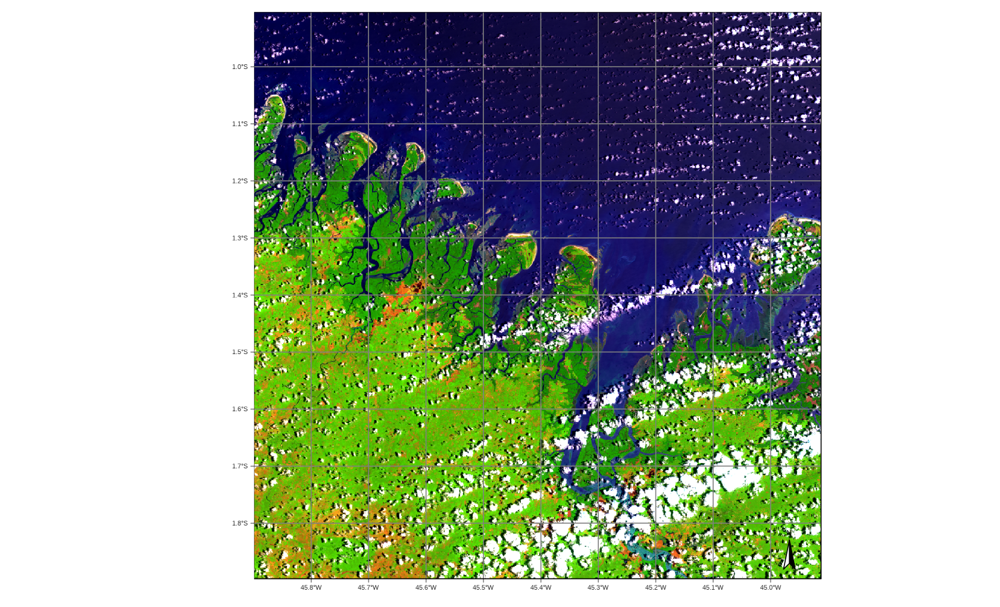

In [4]:
# Create a data cube covering an area in Brazil
s2_23MMU_cube <- sits_cube(
    source = "AWS",
    collection = "SENTINEL-2-L2A",
    tiles = "23MMU",
    bands = c("B02", "B8A", "B11", "CLOUD"),
    start_date = "2018-07-12",
    end_date = "2019-07-28"
)
plot(s2_23MMU_cube, 
     red = "B11", 
     blue = "B02", 
     green = "B8A", 
     date = "2018-10-05"
)

In [5]:
s2_23MMU_cube$file_info[[1]]$path[[1]]

[1] "/vsicurl/https://sentinel-cogs.s3.us-west-2.amazonaws.com/sentinel-s2-l2a-cogs/23/M/MU/2018/7/S2A_23MMU_20180712_0_L2A/B02.tif"

### Assessing Microsoft’s Planetary Computer

Microsoft's Planetary Computer (MPC) hosts two open data collections: `SENTINEL-2-L2A` and `LANDSAT-C2-L2`. The first collection contains SENTINEL-2/2A ARD images, with the same bands and resolutions as those available in AWS (see above). The example below shows how to access the `SENTINEL-2-L2A` collection. 

In [6]:
# create a data cube covering an area in the Brazilian Amazon
s2_35ULA_cube_MPC <- sits_cube(
  source     = "MPC",
  collection = "SENTINEL-2-L2A",
  tiles      = "35ULA",
  bands      = c("B05", "B8A", "B11", "CLOUD"),
  start_date = "2019-07-01",
  end_date   = "2019-07-28"
)



  |======================================================================| 100%


In [7]:
sits_timeline(s2_35ULA_cube_MPC)

[1] "2019-07-01" "2019-07-04" "2019-07-06" "2019-07-09" "2019-07-11"
 [6] "2019-07-14" "2019-07-16" "2019-07-19" "2019-07-21" "2019-07-24"
[11] "2019-07-26"

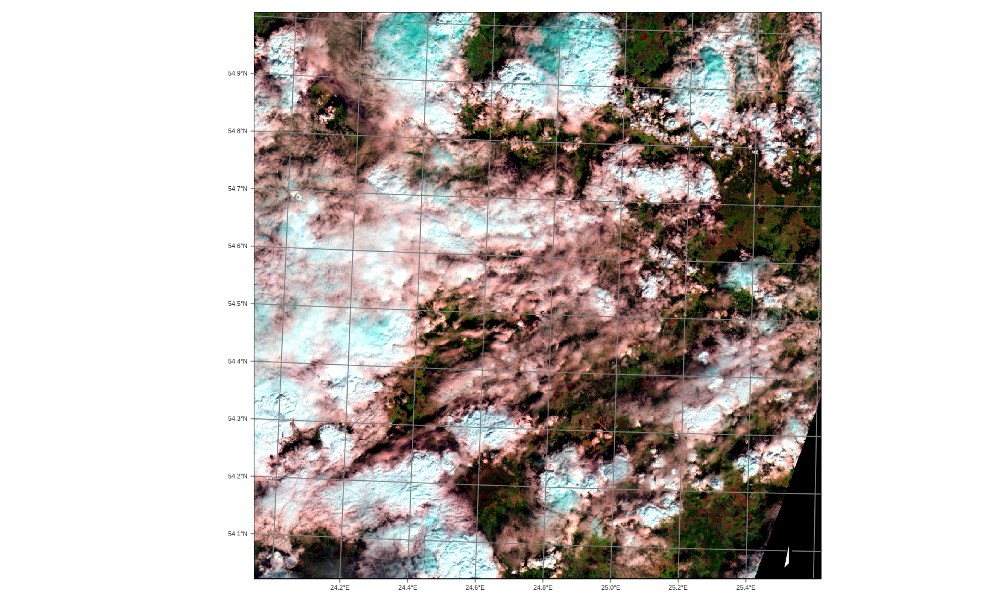

In [8]:
plot(s2_35ULA_cube_MPC, blue = "B05", green = "B8A", red = "B11", date = "2019-07-04")

The `LANDSAT-C2-L2` collection provides access to data from Landsat-4/5/7/8/9 satellites. Images from these satellites have been intercalibrated to ensure data consistency. For compatibility between the different Landsat sensors, the band names are BLUE, GREEN, RED,  NIR08,  SWIR16, and SWIR22. All images have 30 m resolution. For this collection,  tile search is not supported; the `roi` parameter should be used. The example below shows how to retrieve data from a region of interest covering the city of Brasilia in Brazil. 

  |======================================================================| 100%


stars object downsampled to 1023 by 976 cells. See tm_shape manual (argument raster.downsample)



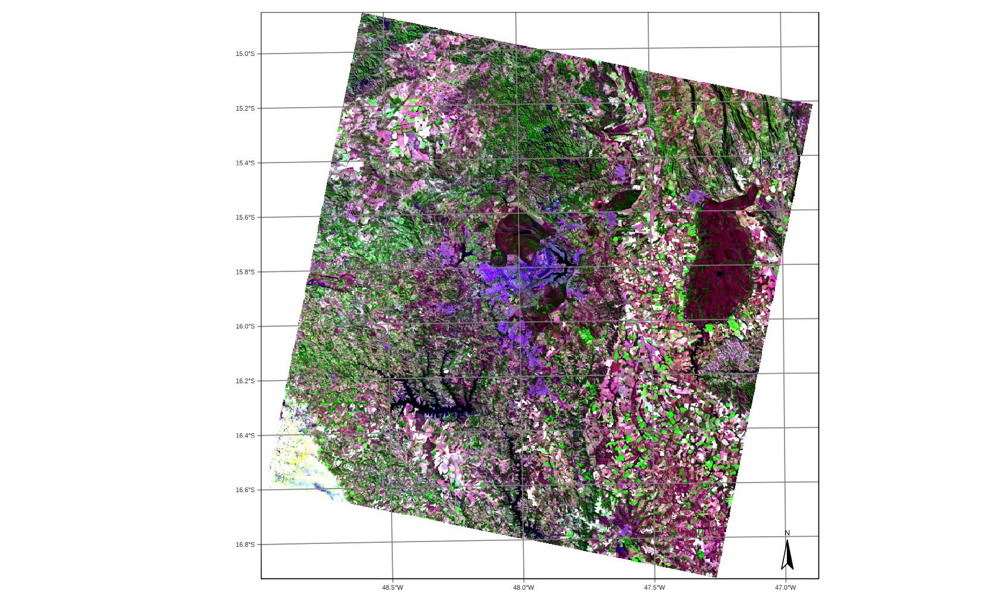

In [9]:
# bounding box of Brasilia city
bbox <- list(
  xmin = -48.2395, 
  ymin = -16.0252, 
  xmax = -47.6814, 
  ymax = -15.4433, 
  crs  = "EPSG:4326"
)

# select the cube
s2_L8_cube_MPC <- sits_cube(
  source     = "MPC",
  collection = "LANDSAT-C2-L2",
  bands      = c("BLUE", "NIR08", "SWIR16", "CLOUD"),
  roi        = bbox,
  start_date = "2019-06-01",
  end_date   = "2019-10-01"
)

# Plot the second tile that covers Brasilia
plot(s2_L8_cube_MPC, red = "SWIR16", green = "NIR08", blue = "BLUE", date = "2019-07-30")

In [10]:
print(s2_L8_cube_MPC$file_info[[1]])

# A tibble: 60 × 14
   fid     date       band   xres  yres  xmin    ymin   xmax    ymax nrows ncols
   <chr>   <date>     <chr> <dbl> <dbl> <dbl>   <dbl>  <dbl>   <dbl> <dbl> <dbl>
 1 LE07_L… 2019-06-04 BLUE     30    30 67485 -1.86e6 309315 -1.66e6  6891  8061
 2 LE07_L… 2019-06-04 CLOUD    30    30 67485 -1.86e6 309315 -1.66e6  6891  8061
 3 LE07_L… 2019-06-04 NIR08    30    30 67485 -1.86e6 309315 -1.66e6  6891  8061
 4 LE07_L… 2019-06-04 SWIR…    30    30 67485 -1.86e6 309315 -1.66e6  6891  8061
 5 LC08_L… 2019-06-12 BLUE     30    30 71085 -1.88e6 298215 -1.65e6  7691  7571
 6 LC08_L… 2019-06-12 CLOUD    30    30 71085 -1.88e6 298215 -1.65e6  7691  7571
 7 LC08_L… 2019-06-12 NIR08    30    30 71085 -1.88e6 298215 -1.65e6  7691  7571
 8 LC08_L… 2019-06-12 SWIR…    30    30 71085 -1.88e6 298215 -1.65e6  7691  7571
 9 LE07_L… 2019-06-20 BLUE     30    30 66585 -1.86e6 308115 -1.66e6  6891  8051
10 LE07_L… 2019-06-20 CLOUD    30    30 66585 -1.86e6 308115 -1.66e6  6891  8051
# ℹ 50 m

### Assessing the Brazil Data Cube

The [Brazil Data Cube](http://brazildatacube.org/en) (BDC) is built by Brazil’s National Institute for Space Research (INPE), to provide regular EO data cubes from CBERS, LANDSAT, SENTINEL-2, and TERRA/MODIS satellites for environmental applications. The collections available in the BDC are: `LANDSAT-OLI-16D` (Landsat-8 OLI, 30 m resolution, 16-day intervals),  `SENTINEL-2-16D` (Sentinel-2A and 2B MSI images at 10 m resolution, 16-day intervals), `CBERS-WFI-16D` (CBERS 4 WFI, 64 m resolution, 16-day intervals), `CBERS-WFI-8D`(CBERS 4 and 4A WFI images, 64m resolution, 8-day intervals) `CBERS-MUX-2M` (CBERS 4/4A MUX, 20 m resolution, two-month intervals), and `MOD13Q1-6` (MODIS MOD13SQ1 product, collection 6, 250 m resolution, 16-day intervals). For more details, use `sits_list_collections(source = "BDC")`.

The BDC uses three hierarchical grids based on the Albers Equal Area projection and SIRGAS 2000 datum. The large grid has tiles of 4224.4 $\times4$ 224.4 km^2^ and is used for CBERS-4 AWFI collections at 64 m resolution; each CBERS-4 AWFI tile contains images of 6600 $\times$ 6600 pixels. The medium grid is used for Landsat-8 OLI collections at 30 m resolution; tiles have an extension of 211.2 $\times$ 211.2 km^2^, and each image has 7040 $\times$ 7040 pixels. The small grid covers 105.6 $\times$ 105.6 km^2^ and is used for Sentinel-2 MSI collections at 10 m resolutions; each image has 10560 $\times$ 10560 pixels. The data cubes in the BDC are regularly spaced in time and cloud-corrected. In the example below, the data cube is defined as one tile ("005004") of `CBERS-WFI-16D` collection, which holds CBERS AWFI images at 16 days resolution.

  |======================================================================| 100%


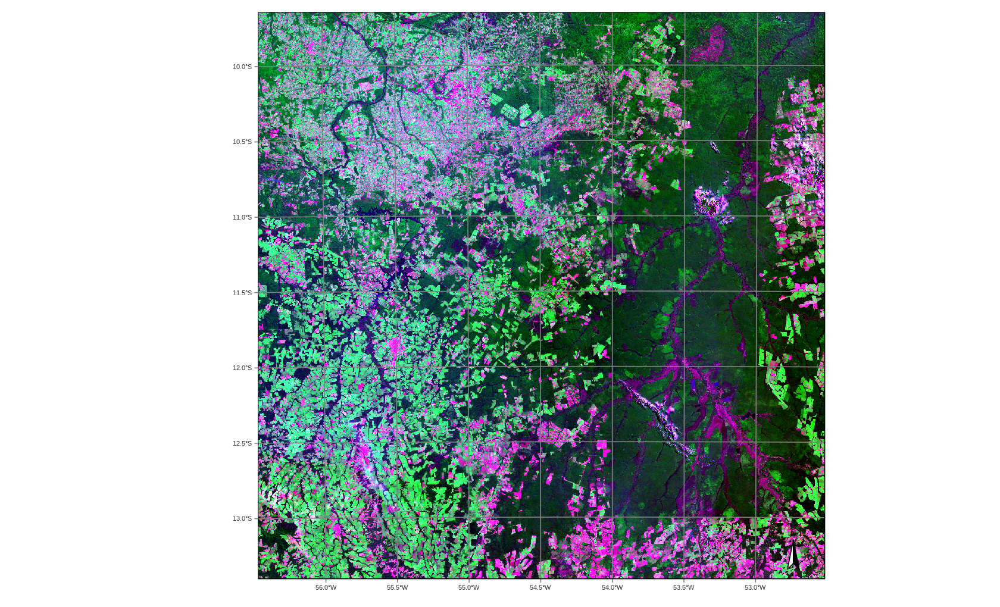

In [11]:
# Define a tile from the CBERS-4/4A AWFI collection
cbers_tile <- sits_cube(
    source = "BDC",
    collection = "CBERS-WFI-16D",
    tiles = "005004",
    bands = c("B13", "B14", "B15", "B16", "CLOUD"),
    start_date = "2021-05-01",
    end_date = "2021-09-01")
# Plot one time instance
plot(cbers_tile, 
     red = "B15", 
     green = "B16", 
     blue = "B13", 
     date = "2021-05-09")

### Assessing Digital Earth Africa{-}

Digital Earth Africa (DEAFRICA) is a cloud service that provides open-access Earth observation data for the African continent. The ARD image collections in `sits` are `S2_L2A` (Sentinel-2 level 2A) and `LS8_SR` (Landsat-8). Since the STAC interface for DEAFRICA does not implement the concept of tiles, users need to specify their area of interest using the `roi` parameter. The requested `roi` produces a cube that contains three MGRS tiles ("35HLD", "35HKD", and "35HLC") covering part of South Africa. 

  |======================================================================| 100%


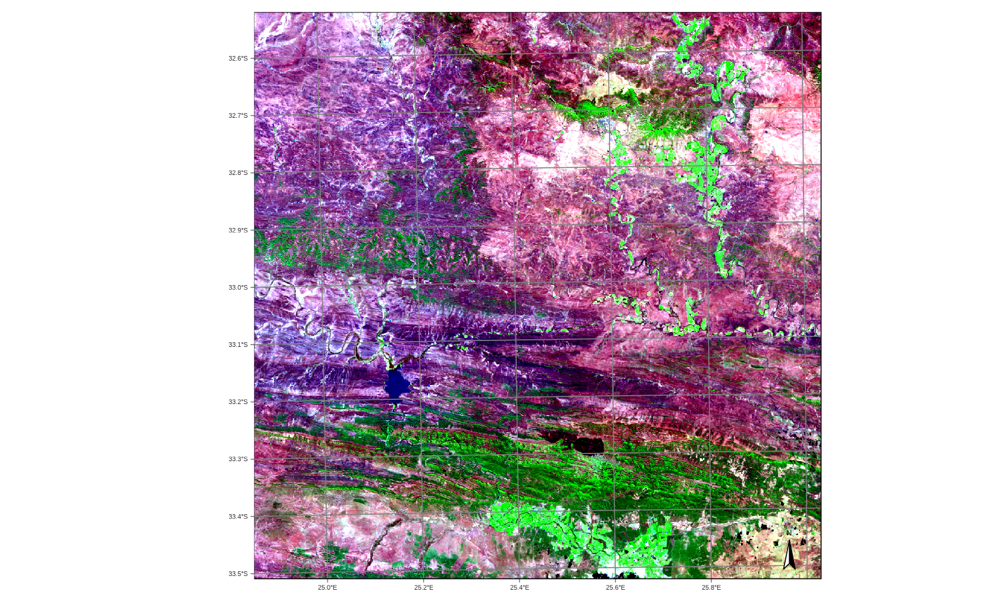

In [12]:
# Create a data cube from Sentinel-2 images available in Digital Earth Africa
dea_cube <- sits_cube(
    source = "DEAFRICA",
    collection = "S2_L2A",
    roi = c(lon_min = 24.97, lat_min = -34.30,
            lon_max = 25.87, lat_max = -32.63),
    bands = c("B05", "B8A", "B11"),
    start_date = "2019-09-01",
    end_date = "2019-10-01")
plot(dea_cube, red = "B11", blue = "B05", green = "B8A")

### Defining a data cube using ARD local files

In [13]:
# Create a cube based on a stack of CBERS data
data_dir <- system.file("extdata/CBERS", package = "sitsdata")
# list the first file
list.files(data_dir)[1]

[1] "CB4_64_16D_STK_022024_2018-08-29_2018-09-13_EVI.tif"

  |======================================================================| 100%


plotting false color image



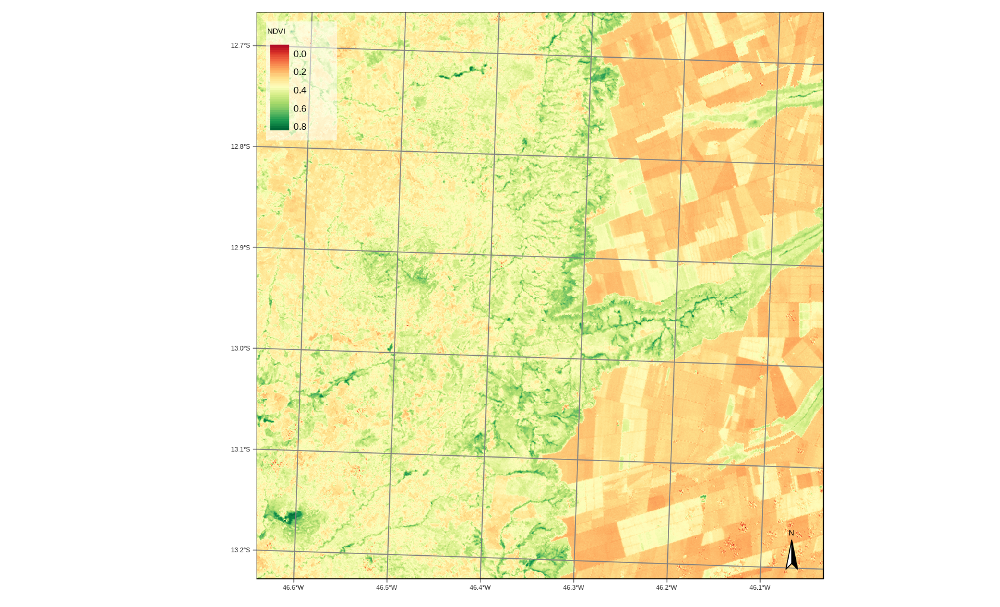

In [14]:
# create a data cube from local files
cbers_cube <- sits_cube(
  source     = "BDC",
  collection = "CBERS-WFI-16D",
  data_dir   = data_dir,
  parse_info = c("X1", "X2", "X3", "X4", "tile", "date", "X5", "band")
)

# plot the band NDVI in the first time instance
plot(cbers_cube, band = "NDVI", date = "2018-08-29")

### Defining a data cube using classified images

  |======================================================================| 100%


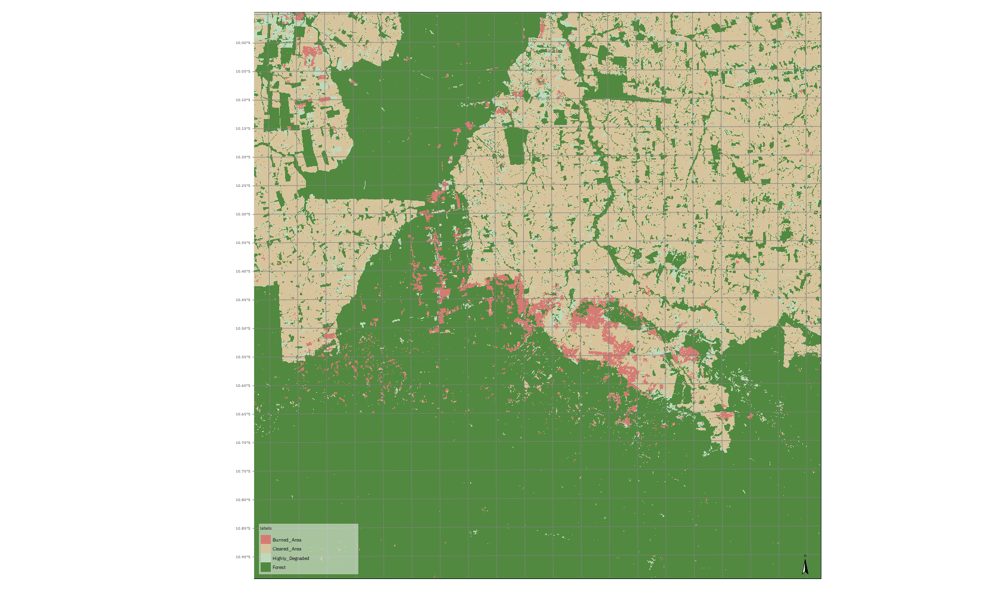

In [15]:
# Create a cube based on a classified image
data_dir <- system.file("extdata/Rondonia-20LLP", package = "sitsdata")
# file is named "SENTINEL-2_MSI_20LLP_2020-06-04_2021-08-26_class_v1.tif"

rondonia_class_cube <- sits_cube(
  source     = "AWS",
  collection = "SENTINEL-S2-L2A-COGS",
  bands      = "class",
  labels     = c("1" = "Burned_Area", "2" = "Cleared_Area", "3" = "Highly_Degraded", "4" = "Forest"),
  data_dir   = data_dir,
  parse_info = c(
    "X1", "X2", "tile", "start_date", "end_date", "band", "version"
  )
)

# plot the classified cube
plot(rondonia_class_cube)

## Regularizing data cubes
<hr style="border:1px solid #0077b9;">

  |======================================================================| 100%


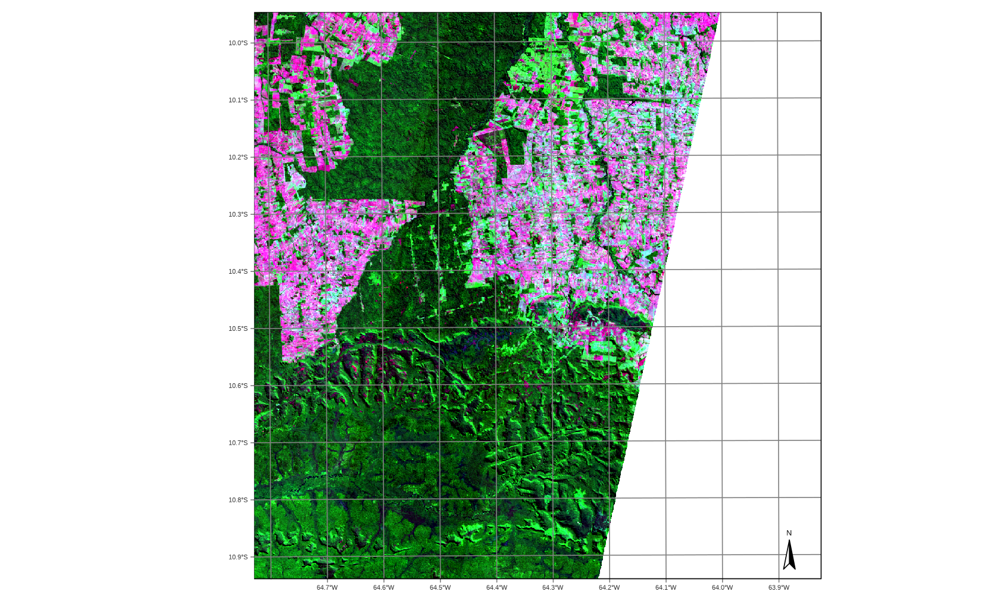

In [16]:
# creating an irregular data cube from AWS
s2_cube <- sits_cube(
  source     = "AWS",
  collection = "SENTINEL-S2-L2A-COGS",
  tiles      = "20LLP",
  bands      = c("B05", "B8A", "B12", "CLOUD"),
  start_date = "2018-07-01",
  end_date   = "2018-08-31"
)

# plot the first image of the irregular cube
plot(s2_cube, red = "B12", green = "B8A", blue = "B05", date = "2018-07-03")

  |======================================================================| 100%


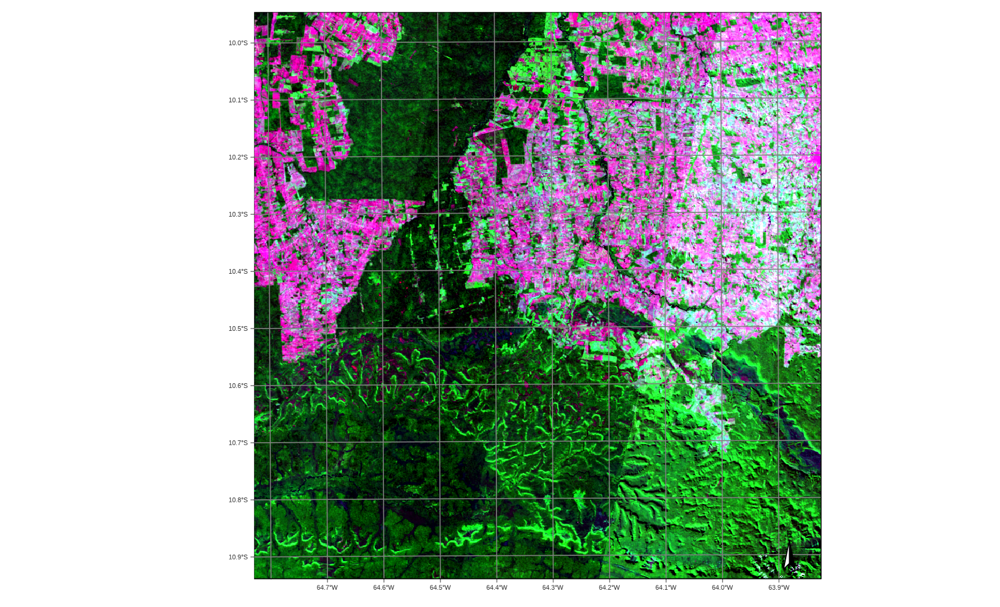

In [17]:
# regularize the cube to 15 day intervals
reg_cube <- sits_regularize(
  cube       = s2_cube,
  output_dir = getwd(),
  res        = 120,
  period     = "P16D",
  multicores = 4
)

# plot the first image of the tile 20LLP of the regularized cube
# The pixels of the regular data cube cover the full MGRS tile
plot(reg_cube, red = "B12", green = "B8A", blue = "B05")

In [18]:
sits_timeline(reg_cube)

[1] "2018-07-03" "2018-07-19" "2018-08-04" "2018-08-20"

HTML widgets cannot be represented in plain text (need html)
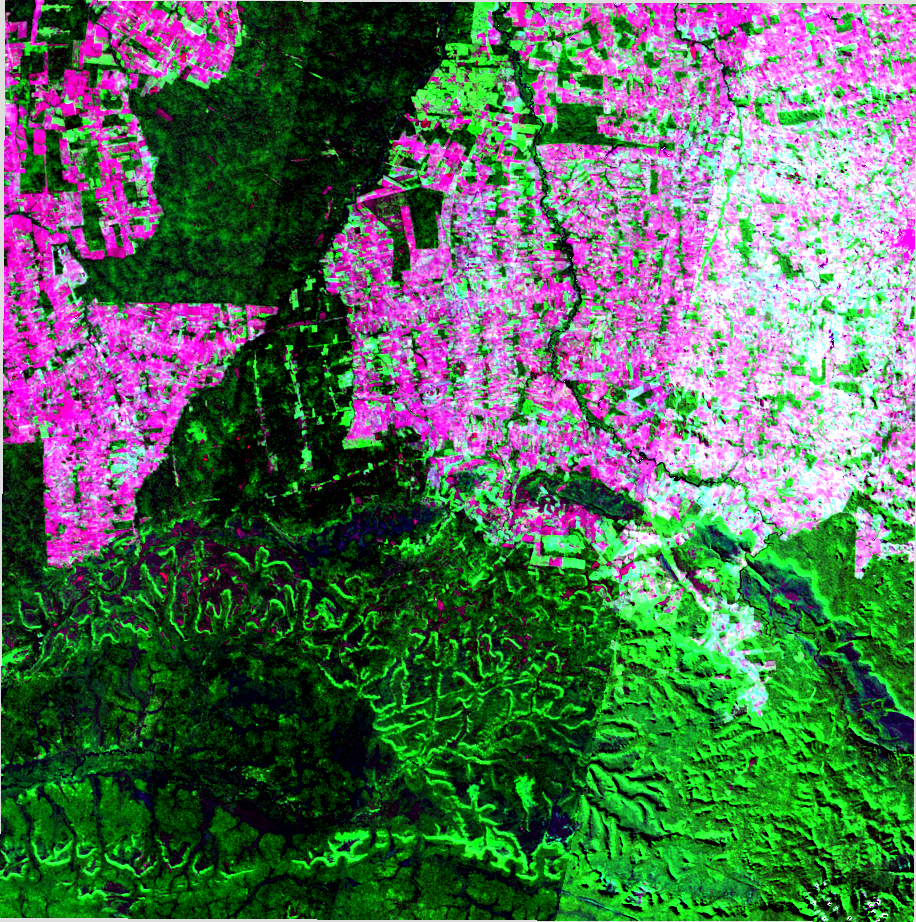

In [19]:
# plot one of the images of the cube
sits_view(reg_cube, red = "B12", green = "B8A", blue = "B05", date = "2018-07-03")

## List supported providers/collections
<hr style="border:1px solid #0077b9;">

In [20]:
# What collections are available in sits? 
sits_list_collections()

BDC:
- CBERS-WFI-16D (CBERS-4/WFI)
- grid system: BDC-Large V2
- bands: NDVI EVI B13 B14 B15 B16 CLOUD
- opendata collection (requires access token)

- CBERS-WFI-8D (CBERS-4-4A/WFI)
- grid system: BDC-Large V2
- bands: NDVI EVI B13 B14 B15 B16 CLOUD
- opendata collection (requires access token)

- CBERS-MUX-2M (CBERS-4/MUX)
- grid system: BDC-Medium V2
- bands: NDVI EVI B05 B06 B07 B08 CLOUD
- opendata collection (requires access token)

- LANDSAT-OLI-16D (LANDSAT-8/OLI)
- grid system: BDC-Medium V1
- bands: NDVI EVI COASTAL BLUE GREEN RED NIR08 SWIR16 SWIR22 CLOUD
- opendata collection (requires access token)

- LANDSAT-2M (LANDSAT/TM-ETM-OLI)
- grid system: BDC-Medium V2
- bands: COASTAL BLUE GREEN RED NIR08 SWIR16 SWIR22 NDVI EVI CLOUD
- opendata collection (requires access token)

- MOD13Q1-6 (TERRA/MODIS)
- grid system: STG
- bands: NDVI EVI BLUE RED NIR MIR CLOUD
- opendata collection (requires access token)

- MYD13Q1-6 (AQUA/MODIS)
- grid system: STG
- bands: NDVI EVI BLUE RED 